<a href="https://colab.research.google.com/github/zhangjt1/Music-Tools/blob/main/MIDI_Granulator.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Uncomment to install dependecies to run on Colab:
!sudo apt-get install fluidsynth
!pip install pretty_midi mir_eval pyfluidsynth

import pretty_midi
import numpy as np
# For plotting
import mir_eval.display
import librosa.display
import matplotlib.pyplot as plt
%matplotlib inline
# For putting audio in the notebook
import IPython.display

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  at-spi2-core fluid-soundfont-gm gsettings-desktop-schemas libatk-bridge2.0-0
  libatk1.0-0 libatk1.0-data libatspi2.0-0 libdouble-conversion3 libevdev2
  libfluidsynth3 libgtk-3-0 libgtk-3-bin libgtk-3-common libgudev-1.0-0
  libinput-bin libinput10 libinstpatch-1.0-2 libmd4c0 libmtdev1 libqt5core5a
  libqt5dbus5 libqt5gui5 libqt5network5 libqt5svg5 libqt5widgets5
  librsvg2-common libwacom-bin libwacom-common libwacom9 libxcb-icccm4
  libxcb-image0 libxcb-keysyms1 libxcb-render-util0 libxcb-util1
  libxcb-xinerama0 libxcb-xinput0 libxcb-xkb1 libxcomposite1
  libxkbcommon-x11-0 libxtst6 qsynth qt5-gtk-platformtheme
  qttranslations5-l10n session-migration timgm6mb-soundfont
Suggested packages:
  fluid-soundfont-gs gvfs qt5-image-formats-plugins qtwayland5 jackd
The following NEW packages will be installed:
  at-spi2-core fluid-soundfont

In [2]:
# load in MIDI file
from pydrive2.auth import GoogleAuth
from pydrive2.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

id='1xbMEEOAN3fmWDKz0IXQ2qJNAjICXe6Dh'
downloaded = drive.CreateFile({'id': id})
downloaded.GetContentFile('bass.mid')

id='1O_8Vu5ShfXMXz8RzplxuvRXQxrpN258N'
downloaded = drive.CreateFile({'id': id})
downloaded.GetContentFile('guitar1.mid')

id='1X5I7EHgUkza5ehip-KJ3iJyZki4I3c3d'
downloaded = drive.CreateFile({'id': id})
downloaded.GetContentFile('guitar2.mid')

id='1xbMEEOAN3fmWDKz0IXQ2qJNAjICXe6Dh'
downloaded = drive.CreateFile({'id': id})
downloaded.GetContentFile('drums.mid')

Loading all instruments into the combined PrettyMIDI object

In [3]:
# List of your MIDI file paths
midi_files = ["bass.mid", "guitar1.mid", "guitar2.mid"] # ignoring drums for now

def load_midi_files(midi_files, initial_tempo=None):
  # Create an empty PrettyMIDI object to hold everything
  if initial_tempo:
    combined = pretty_midi.PrettyMIDI(initial_tempo=initial_tempo)
  else:
    combined = pretty_midi.PrettyMIDI()

  # Loop through and load each file
  for midi_file in midi_files:
      pm = pretty_midi.PrettyMIDI(midi_file)
      combined.instruments.append(pm.instruments[0])

  return combined

In [4]:
def plot_piano_roll(pm, start_pitch, end_pitch, fs=100):
    # Use librosa's specshow function for displaying the piano roll
    librosa.display.specshow(pm.get_piano_roll(fs)[start_pitch:end_pitch],
                             hop_length=1, sr=fs, x_axis='time', y_axis=None,
                             fmin=pretty_midi.note_number_to_hz(start_pitch))

Visualize MIDI file and beats

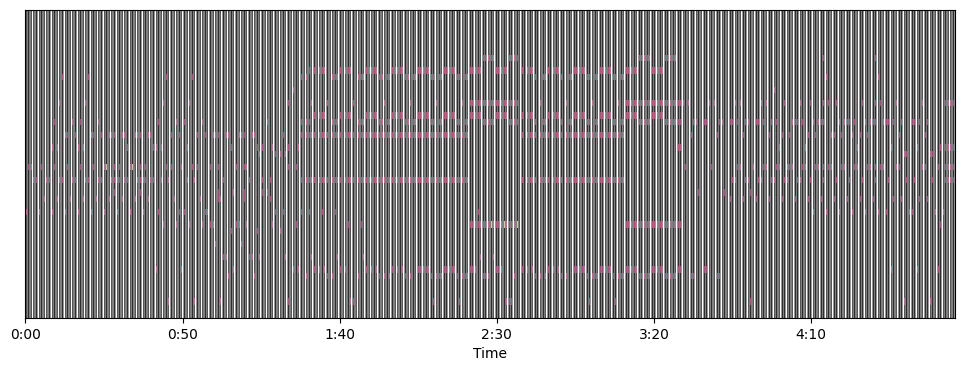

In [68]:
combined = load_midi_files(midi_files, 116)

beats = combined.get_beats()
downbeats = combined.get_downbeats()

plt.figure(figsize=(12, 4))

plot_piano_roll(combined, 36, 84)

# Plot beats as grey lines, downbeats as white lines
ymin, ymax = plt.ylim()

for beat in beats:
    plt.plot([beat, beat], [ymin, ymax], color='grey', linewidth=1)
for beat in downbeats:
    plt.plot([beat, beat], [ymin, ymax], color='white', linewidth=1)

plt.show()

# Synthesis frequency
fs = 16000
IPython.display.Audio(combined.synthesize(fs=16000), rate=16000)

In [69]:
import numpy as np
import copy
from collections import defaultdict

def get_grains(combined, grain_size, play_back_speed):

  # divide notes by grains
  grouped_notes = defaultdict(list)

  for instrument in combined.instruments:
    # group note by grain bucket
    for note in instrument.notes:
      temp_note = copy.deepcopy(note)
      temp_note.start = (note.start % grain_size) * (1.0 / play_back_speed)
      temp_note.end = (temp_note.start + (note.end - note.start)) * (1.0 / play_back_speed)
      note_grain = (note.start // grain_size) * grain_size
      grouped_notes[note_grain].append(temp_note)

  return grouped_notes

def scramble_grains(grouped_notes, grain_size, probability, audio_length, drop_probability):
  sequence = np.arange(0, audio_length, grain_size)

  # randomly swap elements in sequences with other elements nearby
  for i in range(len(sequence)):
    # random chance to swap
    if np.random.rand() < probability:
      # swap with random neighbor
      j = np.random.randint(max(0, i - 8), min(len(sequence), i + 8))
      sequence[i], sequence[j] = sequence[j], sequence[i]

  remixed_notes = []

  for new_i, i in enumerate(sequence):
    if np.random.rand() < drop_probability:
      continue
    for notes in grouped_notes[i]:
      new_note = copy.deepcopy(notes)
      new_note.start += grain_size * new_i
      new_note.end +=  grain_size * new_i
      remixed_notes.append(new_note)

  return remixed_notes


def granulate(combined, grain_size, probability=0.5, play_back_speed=1.0, drop_probability=0.0):
  # increment by grain size (sec) until end time
  audio_length = combined.get_end_time()
  grouped_notes = get_grains(combined, grain_size, play_back_speed)
  remixed_notes = scramble_grains(grouped_notes, grain_size, probability, audio_length, drop_probability)
  return sorted(remixed_notes, key=lambda x: x.start)

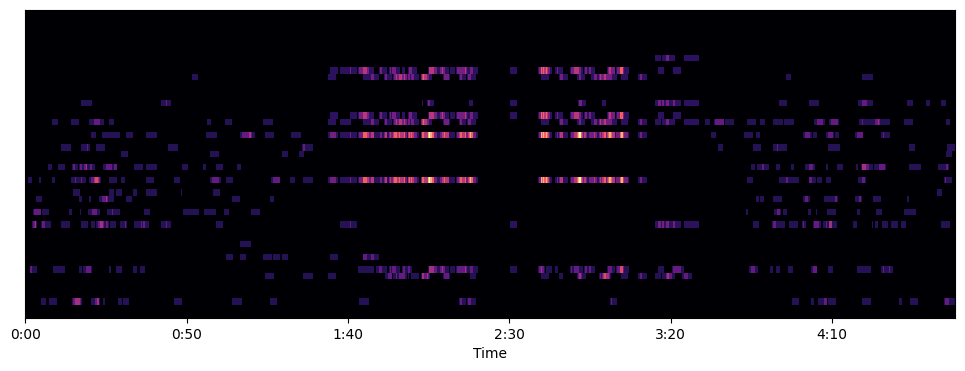

In [70]:
granulated_result = granulate(combined, 0.3, 0.8, 0.3, 0.8)

inst = pretty_midi.Instrument(program=0, is_drum=False, name='granulated')
inst.name = 'granulated'
inst.notes = granulated_result

plt.figure(figsize=(12, 4))

plot_piano_roll(inst, 36, 84)
plt.show()

# Synthesis frequency
fs = 16000
IPython.display.Audio(inst.synthesize(fs=16000), rate=16000)